# PW 1 - Practical work on SAR imaging : introduction to SAR data and interferometric processing 
The aim of this PW is to get familiar with SAR data (high dynamic of the images, complex data with ampltidue and phase). After a first part on the visualization of such data and the understanding of the image content, the second part is dedicated to the processing of phase and interferometric data.

## 1. Download of Sentinel-1 SAR images from ESA website
This part explains how to download freely Sentinel-1 images provided by ESA (European Space Agency) on a place defined by its latitude and longitude coordinates. We will use the Peps plateform developed by the CNES (french space agency). mvalab.py contains some useful functions to manipulate SAR data.
- look for the coordinates on [OpenStreetMap](https://www.openstreetmap.org) or [Google Maps](https://www.google.com/maps)
- choose product type (SLC or GRD)
- SLC = Single Look Complex (complex format)
- GRD = Ground Range Detected (amplitude format)
- Choose two dates to select a search window

#### To run the cell below and dowload images from the ESA website, you need first to create an account on https://peps.cnes.fr/rocket/#/register

In [2]:
!git clone https://github.com/olivierhagolle/peps_download.git
with open('./peps.txt', 'x') as f:
  f.write('jutogashi@poli.ufrj.br 3SkDQFSjBS.X35G') # replace it with your login information

!wget https://perso.telecom-paristech.fr/dalsasso/TPSAR/mvalab.py

from osgeo import gdal
import numpy as np
import matplotlib.pyplot as plt

def read_tiff(chemin):
  dataset = gdal.Open(chemin)
  for x in range(1, dataset.RasterCount + 1):
    band = dataset.GetRasterBand(x)
    array = band.ReadAsArray()
  return array


Cloning into 'peps_download'...
remote: Enumerating objects: 190, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 190 (delta 0), reused 0 (delta 0), pack-reused 187
Receiving objects: 100% (190/190), 55.11 KiB | 5.51 MiB/s, done.
Resolving deltas: 100% (98/98), done.
--2021-05-04 19:52:56--  https://perso.telecom-paristech.fr/dalsasso/TPSAR/mvalab.py
Resolving perso.telecom-paristech.fr (perso.telecom-paristech.fr)... 137.194.2.165, 2001:660:330f:2::a5
Connecting to perso.telecom-paristech.fr (perso.telecom-paristech.fr)|137.194.2.165|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 68035 (66K) [text/x-python]
Saving to: ‘mvalab.py’

mvalab.py           100%[===================>]  66.44K  --.-KB/s    in 0.1s    

2021-05-04 19:52:57 (498 KB/s) - ‘mvalab.py’ saved [68035/68035]



### Example
Download of a Sentinel-1 GRD SAR image on the area of Saclay: the research engine looks for the area that intersects the rectangle formed with the geographic coordinates. You can modify the values to search for any place you are interested in. 
The mvalab.visusar function is used for display.

In [2]:
!python ./peps_download/peps_download.py -c S1 -p GRD -x True -m IW --lonmin 2.17 --lonmax 2.23 --latmin 48.70 --latmax 48.72 -a peps.txt -d 2021-04-02 -f 2021-04-03

curl -k -o search.json https://peps.cnes.fr/resto/api/collections/S1/search.json?box=2.17,48.7,2.23,48.72\&startDate=2021-04-02\&completionDate=2021-04-03\&maxRecords=500\&productType=GRD\&sensorMode=IW
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 11604    0 11604    0     0   8831      0 --:--:--  0:00:01 --:--:--  8831
S1B_IW_GRDH_1SDV_20210402T060642_20210402T060707_026284_03230F_8648 disk
##########################
1  products to download
##########################
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 11602    0 11602    0     0   9548      0 --:--:--  0:00:01 --:--:--  9548
S1B_IW_GRDH_1SDV_20210402T060642_20210402T060707_026284_03230F_8648 disk
S1B_IW_GRDH_1SDV_20210402T060642_20210402T060707_026284_03230F_8648 already exists


In [ ]:
# Read the data (amplitude) contained in the subfolder 'measurements' and store it into a numpy array
ima_GRD = read_tiff('/content/S1B_IW_GRDH_1SDV_20210402T060642_20210402T060707_026284_03230F_8648.SAFE/measurement/s1b-iw-grd-vh-20210402t060642-20210402t060707-026284-03230f-002.tiff')
mvalab.visusar(ima_GRD)


Affichage d'une image reelle


In [ ]:
ima_saclay = np.flip(ima_GRD,axis=1)
mvalab.visusar(ima_saclay[15500:16000,22500:23500])

## 2. Analysis of a series of SAR images
In this part, we will have a look at a temporal series of 25 SAR images acquired [from 2015-10-06 to 2016-11-05](https://perso.telecom-paristech.fr/dalsasso/TPSAR/pilelely/PileLely_3072x1024RECALZ4.label), with a time delay of approximately 12 days.

By making use of this SAR images, we will see the main differences with respect to conventional natural images and develop some simple tools to visualize an image, interpret it and detect temporal changes.

In [3]:
!wget https://perso.telecom-paristech.fr/dalsasso/TPSAR/mvalab.py

import scipy
from scipy import signal
import scipy.signal
import scipy as spy
import scipy.fftpack
from scipy import ndimage
from scipy import special
from scipy import ndimage
import numpy as np
import math
import matplotlib.pyplot as plt
import mvalab as mvalab
from urllib.request import urlopen
import cmath
from google_drive_downloader import GoogleDriveDownloader as gdd


plt.rcParams['figure.figsize'] = [8, 8]
plt.rcParams['figure.max_open_warning'] = 30

--2021-05-04 19:52:59--  https://perso.telecom-paristech.fr/dalsasso/TPSAR/mvalab.py
Resolving perso.telecom-paristech.fr (perso.telecom-paristech.fr)... 137.194.2.165, 2001:660:330f:2::a5
Connecting to perso.telecom-paristech.fr (perso.telecom-paristech.fr)|137.194.2.165|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 68035 (66K) [text/x-python]
Saving to: ‘mvalab.py.1’

mvalab.py.1         100%[===================>]  66.44K  --.-KB/s    in 0.1s    

2021-05-04 19:53:00 (494 KB/s) - ‘mvalab.py.1’ saved [68035/68035]



In [4]:
# Download of the time series
webpage = 'https://perso.telecom-paristech.fr/dalsasso/TPSAR/pilelely/multitemp/'
imagename = 'lely_tuple_multitemp.IMA'
imaslc = mvalab.imz2mat(webpage+imagename) # complex image

time_series_amp = np.abs(imaslc[0]) # taking an array of shape [n_rows,n_columns,n_dates] in amplitude format

imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/dalsasso/TPSAR/pilelely/multitemp/lely_tuple_multitemp.IMA
Nom compatible url
Nom compatible url
INFO - reading header/dim : https://perso.telecom-paristech.fr/dalsasso/TPSAR/pilelely/multitemp/lely_tuple_multitemp.dim
Multitemporal image 25 data
Fichiers PC
Image  complex float
lecture .dim OK -> largeur:512 hauteur:512 profondeur:25
Debug 2 4 512
4 512 <f


### Question 2.1: display a SAR image
SAR images have a long-tailed distribution, making its dynamic range to be wide. Plot the image with matplotlib. What do you see? 

It looks like an optical image with a low exposition and a low contrast. How can you improve the contrast of a SAR image, in order to have a more pleasant visualization?
Implement a function to plot a SAR image and comment the results obtained. 

A usual way to do this, is the saturate all the values above a certain threshold (often chosen as the mean + 3 times the standard deviation of the image) and do a linear stretching for the other values. 
Explain the effect of this processing and what you see in the resulting image. 

### Answer 2.1
The image is almost all black, with just some white points. 


We can define a threshold to “cut” the long tail of the distribution. 


After the preprocessing the gray levels of the image aren’t so discrepant, so now we can see the difference between subtle changes in gray level. With that we are able to observe a more clear image. In the image we can see some fields, with so constructions (town) in the middle (the lighter part). We can see some roads and in the bottom water.


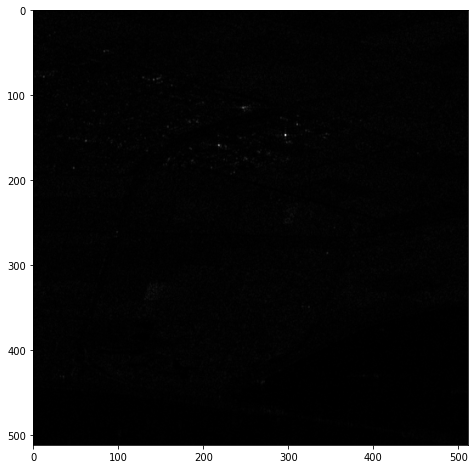

In [5]:
plt.figure()
plt.imshow(time_series_amp[:,:,0],cmap='gray')
plt.show()

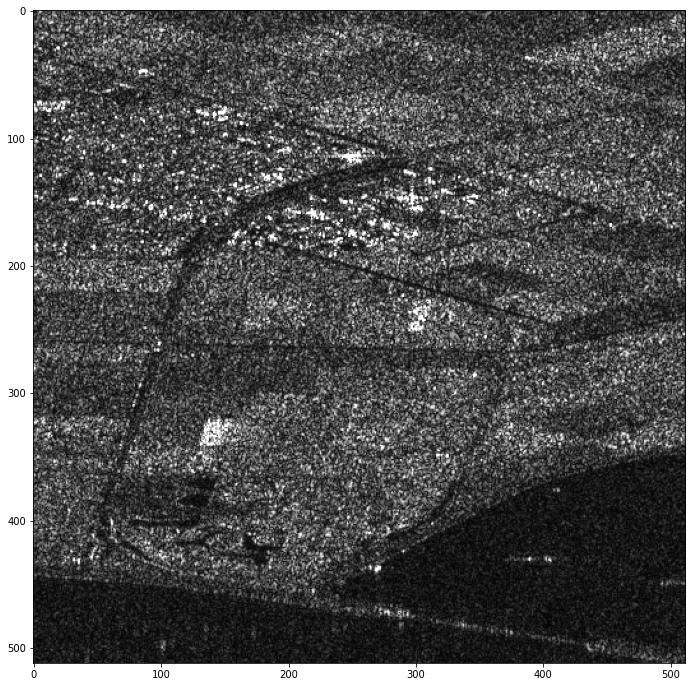

In [6]:
# implement the following function to plot a SAR image
# you can use a threshold as mean + 3 sigma
# and the np.clip function

def plot_sar(ima):
  plt.figure(figsize=(12,12))
  t = ima.mean() + 3*ima.std() # choose the appropriate theshold
  plt.imshow(np.clip(ima,0,t),cmap='gray') # display the saturated image
  plt.show()

plot_sar(time_series_amp[:,:,0])

### Question 2.2: Image orientation
Is the image in the correct geographic orientation? Can you deduce if it has been acquired in ascending (from south to nord) or descending (from north to south) orbit, knowing that the radar is pointing to the right? 
Apply the proper flipping if necessary.

To see the corresponding optical image, you can have a look on Google Maps at [this location](https://goo.gl/maps/LQcd3Uz9U7qCoRrH6).

### Answer 2.2
The image is inversed in the vertical axe. The radar is going from the south to the north (ascending).

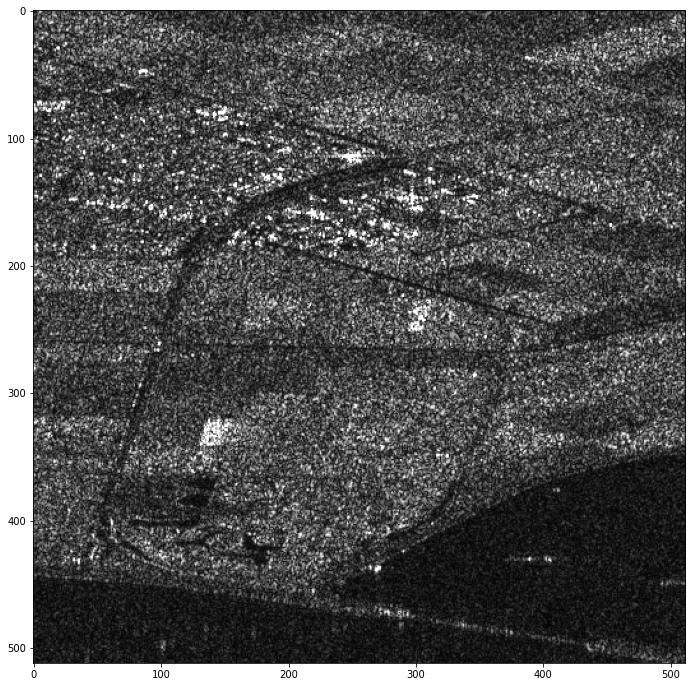

In [7]:
plot_sar(time_series_amp[:,:,0])

In [10]:
time_series_flipped = np.copy(time_series_amp)
time_series_flipped = np.flip(time_series_flipped,axis=0) # apply flipping if necessary

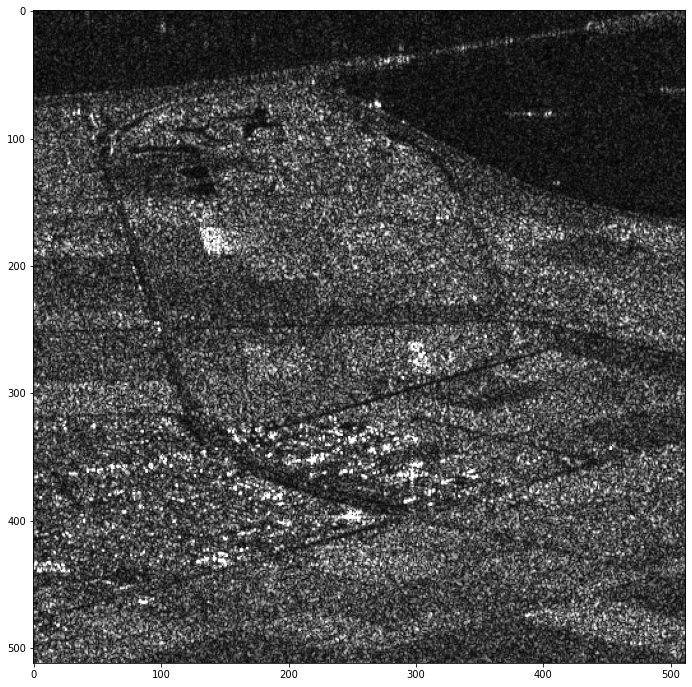

In [11]:
plot_sar(time_series_flipped[:,:,0])

### Question 2.3: Interpretation of a SAR image
The image contains 
- an urban area, 
- agricultural fields, 
- water, 
- moving objects (ships), 
- a bridge 

Can you give the approximate coordinates of these areas?

Explain the appearence of water, vegetated areas and urban areas.

### Answer 2.3
- urban area: Around (300,400) in vertical axes and (150, 350) in horizontal axes.
- agricultural fields: rest of the image
- water: (0,100) in vertical axes and (0,500) in horizontal axes.
- moving objects (ships): 70 in vertical axes and 400  in horizontal axes.
- the bridge: (0,50) in vertical axes and (300,500) in horizontal axes.

**Coordinates given based on the flipped image in 2.2.**


The water appears as black because is a smooth surface, so the signal reflects on it and doesn’t come back to the sensor. The signal from vegetation areas will depend on the complex interaction of the penetrating signal (in the image is in some middle gray levels), and the urban areas will appear light due to the corners of constructions. 



### Question 2.4: Multitemporal analysis and change detection
To detect changes occurring between three dates, images can be displayed in a false colour representation, each date being one channel of a RGB image. Implement the function ```plot_changes```.

Then, choose three dates from the multitemporal stack (indexes from 0 to 24). From the false colour representation, can you tell when a particular change has occurred? Explain how you can interpret it.

### Answer 2.4
Yes. In the color image, the areas that kept similar between the 3 days are close to gray levels and the areas that are one color represent some change (if an area is red, that area is lighter in the first image for example).


As can be seen above, most of the change occurs in the fields (the city stays the same), this can be due for example to the humidity of the crops, if they have grown or were harvested.


In [12]:
def plot_changes(im1,im2,im3):
    threshold = im1.mean() + 3*im1.std() # select a unique threshold for the three images
    # apply thresholding and shrinking of each image between [0;1] for RGB data
    im1 = np.clip(im1,0,threshold)
    im1 = im1/threshold
    im2 = np.clip(im2,0,threshold)
    im2 = im2/threshold
    im3 = np.clip(im3,0,threshold)
    im3 = im3/threshold
    image = np.stack((im1,im2,im3), axis=-1) # create a false RGB image by stacking the three dates
    plt.figure(figsize=(12,12))
    plt.imshow(image)
    plt.show()

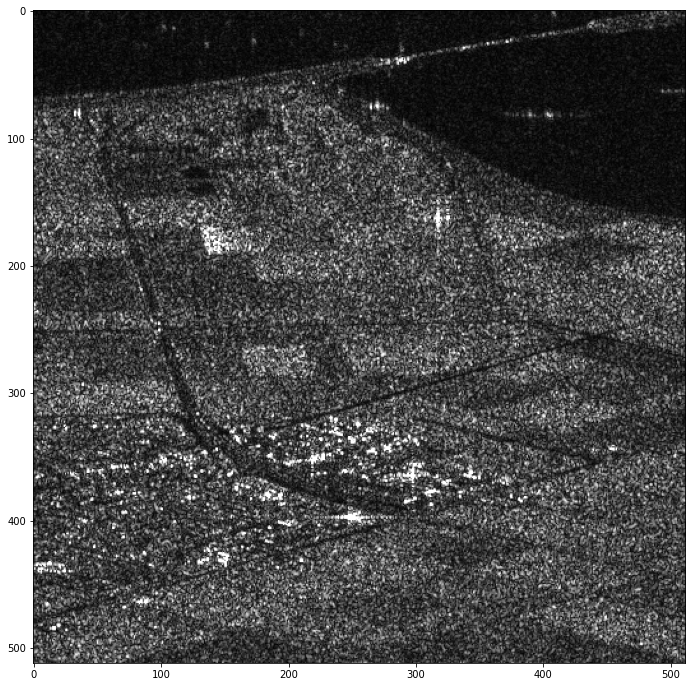

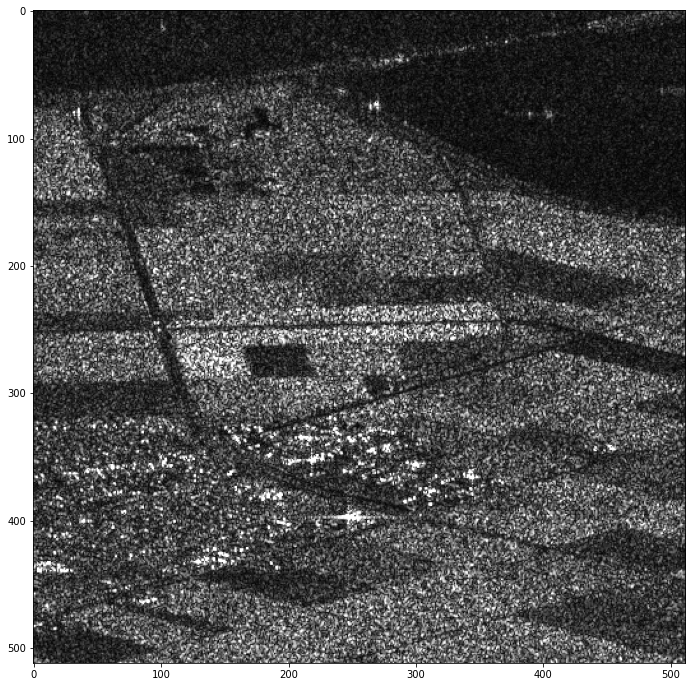

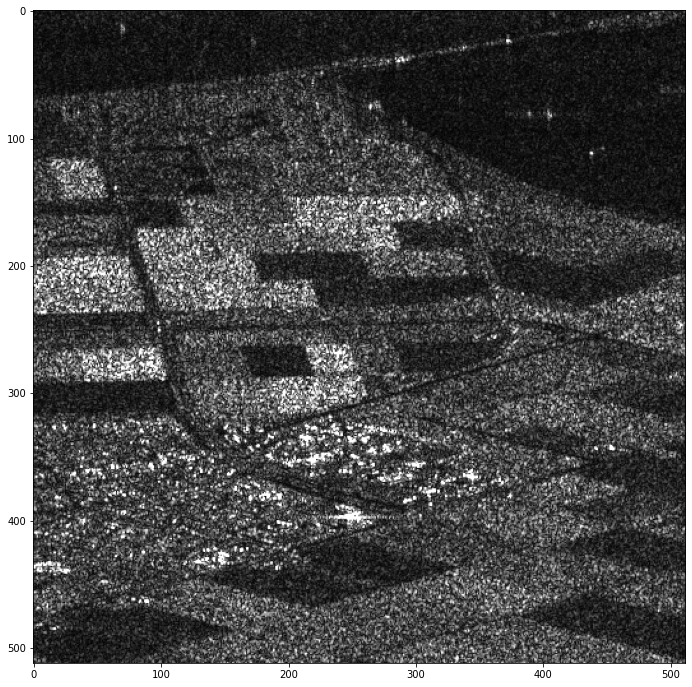

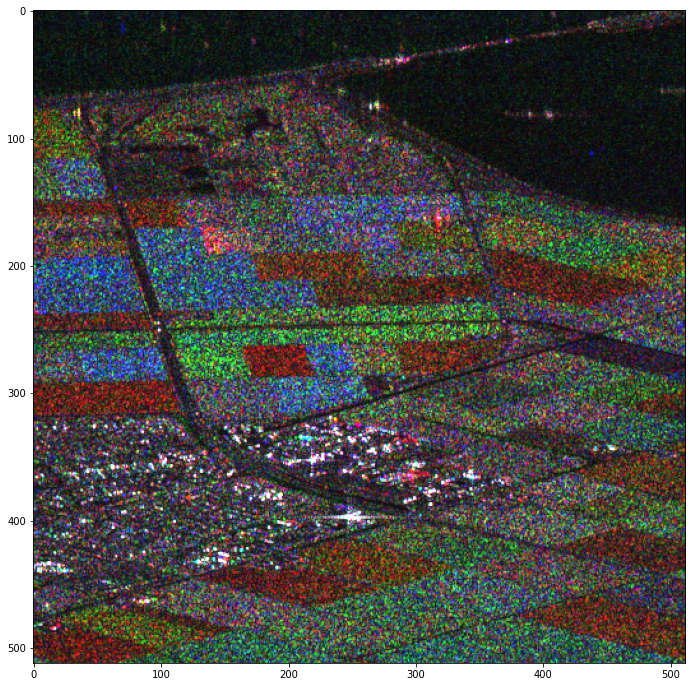

In [13]:
# choose three dates
idx1 = 1 
idx2 = 10 
idx3 = 15
im1 = time_series_flipped[:,:,idx1]
im2 = time_series_flipped[:,:,idx2]
im3 = time_series_flipped[:,:,idx3]

plot_sar(im1)
plot_sar(im2)
plot_sar(im3)
plot_changes(im1,im2,im3)

### Question 2.5: Create an image with isotropic pixels
The image pixels have the following size: $13.86[m]\times 2.3[m]$ in range $\times$ azimuth (approximately, pixel height is 5 times greater than pixel length). How can you create an image with approximately squared pixels?

### Answer 2.5
We convolute our original image with a mask of proportion 1:5. This gives us an elongated image, but that has less noise (we can see the buildings/roads more clearly). 

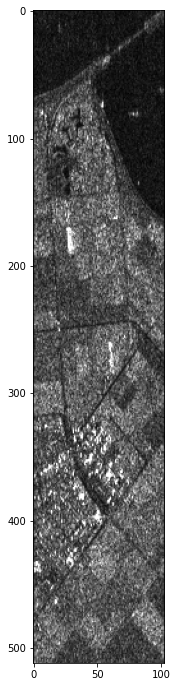

In [14]:
ima_tmp = time_series_flipped[:,:,0]

mask = np.ones((1,5))/5
ima_filtered = scipy.signal.convolve2d(ima_tmp,mask,mode='same') # filter the image with the appropriate mask
ima_squared_pixels = ima_filtered[:,::5] # resample the filtered image
plot_sar(ima_squared_pixels)

## 3. Analysis of TerraSAR-X images acquired over the Paris area
In this part we will use an image of TerraSAR-X sensor (metric resolution) of Paris. 
This is a temporal stack, you can choose the date you want. 

imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/dalsasso/TPSAR/paris/PileiEiffeljavelRECALZ4RECSP.IMA
Nom compatible url
Nom compatible url
INFO - reading header/dim : https://perso.telecom-paristech.fr/dalsasso/TPSAR/paris/PileiEiffeljavelRECALZ4RECSP.dim
Multitemporal image 21 data
Fichiers PC
Image  complex short
lecture .dim OK -> largeur:2048 hauteur:2048 profondeur:21
Debug 2 2 2048
2 2048 <h
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


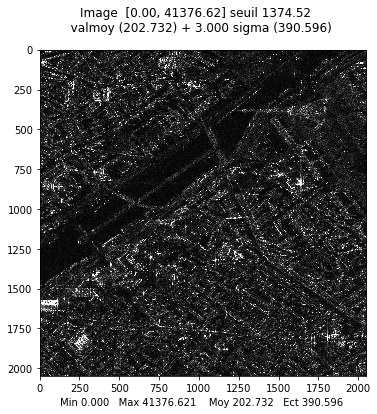

array([[ 58.30951895,  59.07622195, 145.77379737, ...,  22.84731932,
         42.05948169,   5.83095189],
       [ 90.00555538,  64.77653896, 117.08543889, ...,  41.76122604,
         17.80449381,   2.        ],
       [259.49373788, 153.83432647,  92.00543462, ..., 129.18978288,
         80.80222769,  43.18564576],
       ...,
       [132.37069162, 283.06359709, 409.33238328, ...,  88.05112151,
         62.03224968,  11.04536102],
       [ 36.76955262, 239.15058018, 382.41469637, ...,  11.        ,
         44.72135955,  10.        ],
       [100.56838469, 189.78145326, 234.04700383, ...,  17.49285568,
         94.42986816,   8.60232527]])

In [15]:
# 21 images from TerraSAR-X between 2009-01-24 and 2010-11-26
webpage='https://perso.telecom-paristech.fr/dalsasso/TPSAR/paris/'
image='PileiEiffeljavelRECALZ4RECSP.IMA'
im_slc_tsx_paris_liste=mvalab.imz2mat(webpage+image);
im_slc_tsx_paris = im_slc_tsx_paris_liste[0][:,:,0]
plt.rcParams['figure.figsize'] = [6, 6]
mvalab.visusar(np.abs(im_slc_tsx_paris))

### Question 3.1: interpretation
Check that you recognize the main buildings on this image. 
What is the position of the track of the sensor relatively to this image ?

Explain the appearence of the following buildings in the amplitude image : Eiffel Tower, Maison de la radio, Pont de Bir-Hakeim (you can use a [satellite optic image on googlemaps](https://www.google.com/maps/place/Eiffel+Tower/@48.851143,2.2797819,447m/data=!3m1!1e3!4m5!3m4!1s0x47e66e2964e34e2d:0x8ddca9ee380ef7e0!8m2!3d48.8583701!4d2.2944813) to help you).



### Answer 3.1
We can see the Seine in the top of the image and the Tour Eiffel in the top right corner. The sensor is to the left (the top of the Tour is to the left, and it was what was captured first, being the tallest point).


The Tour suffers from layover with the ground, so its image is not that clear (a pixel corresponds to the Tour and the ground). We can see the shadow projected by the Maison de Radio to its right. And at last, the Pont is overall clear, with some more bright points that correspond to the vehicles going across it.   


### Question 3.2: change detection
Identify and explain the appearence of some changing objects on Paris.

### Answer 3.2
We can see that, as Paris is an urban zone, few changes occur (specially if we compare to the fields in the last example). Most changes are concentrated to the boats in the river, that evidently changed position. Also, the roads, with the movement of the cars. One or other building is marked as change, that may do to some construction/restoration.

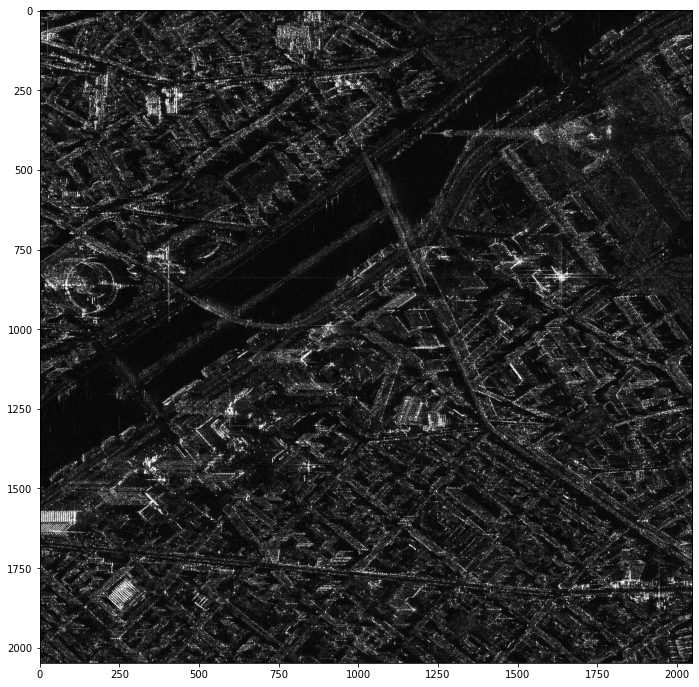

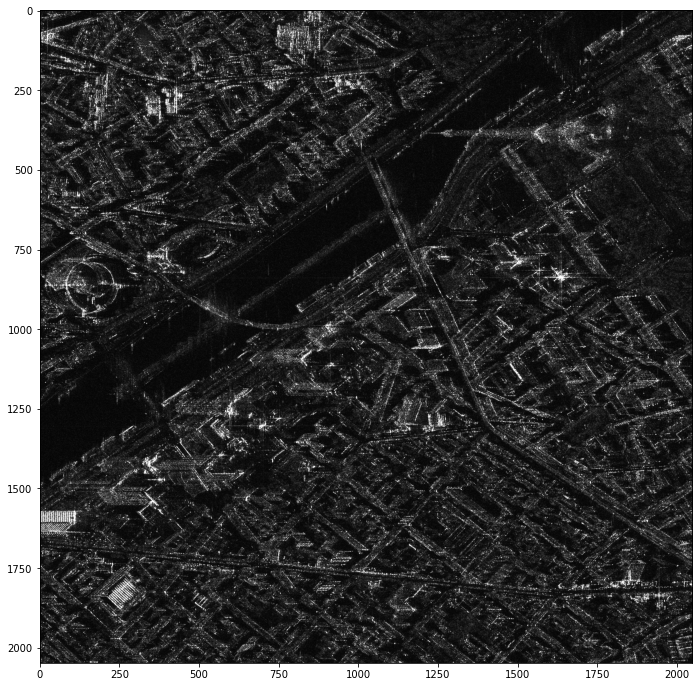

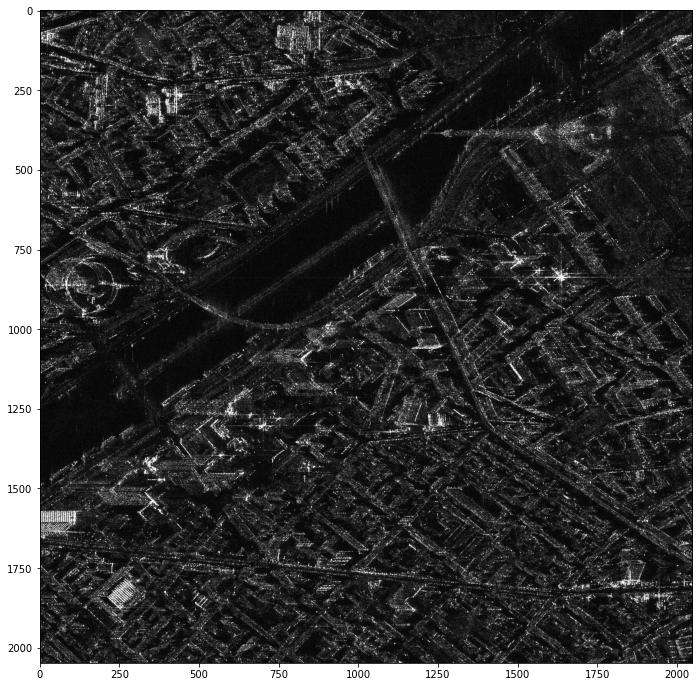

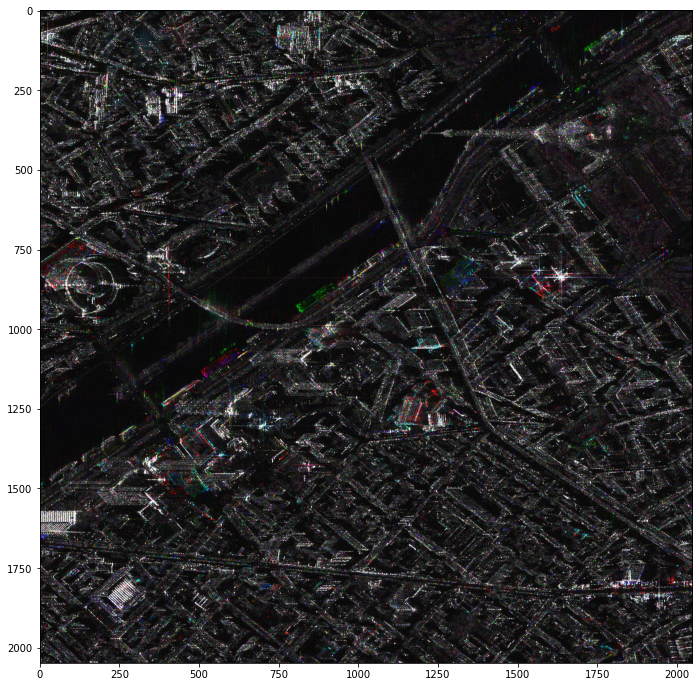

In [16]:
idx1 = 1 
idx2 = 10 
idx3 = 15
im1 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx1])
im2 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx2])
im3 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx3])

plot_sar(im1)
plot_sar(im2)
plot_sar(im3)
plot_changes(im1,im2,im3)

## 4. SAR interferometry
In this part, the objective is to see the content of the phase of a SAR image and to do a simple processing chain to obtain an interferogram with topographic fringes. 
You will be able to have a look to the optical image [on this link](https://g.page/ParcoEtna?share)

In [17]:
# use the previous steps to process Etna data
gdd.download_file_from_google_drive(file_id='1MKeUpH3ovVG9hjfEY2UVl6InwswFKpC2',
                                    dest_path='./interfero.zip',
                                    unzip=True)

Unzipping...Done.


Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


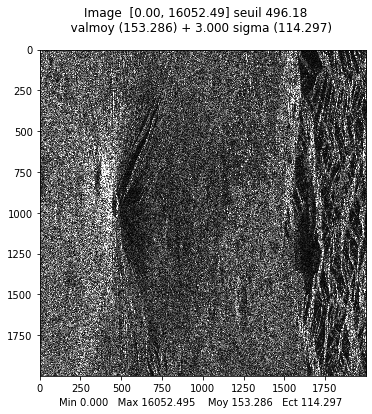

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


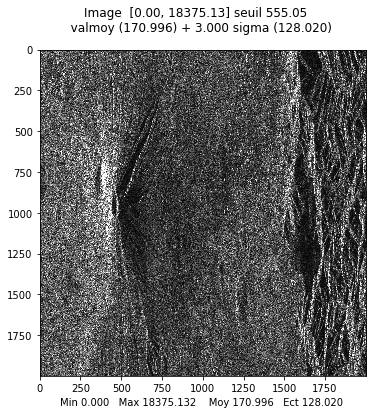

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


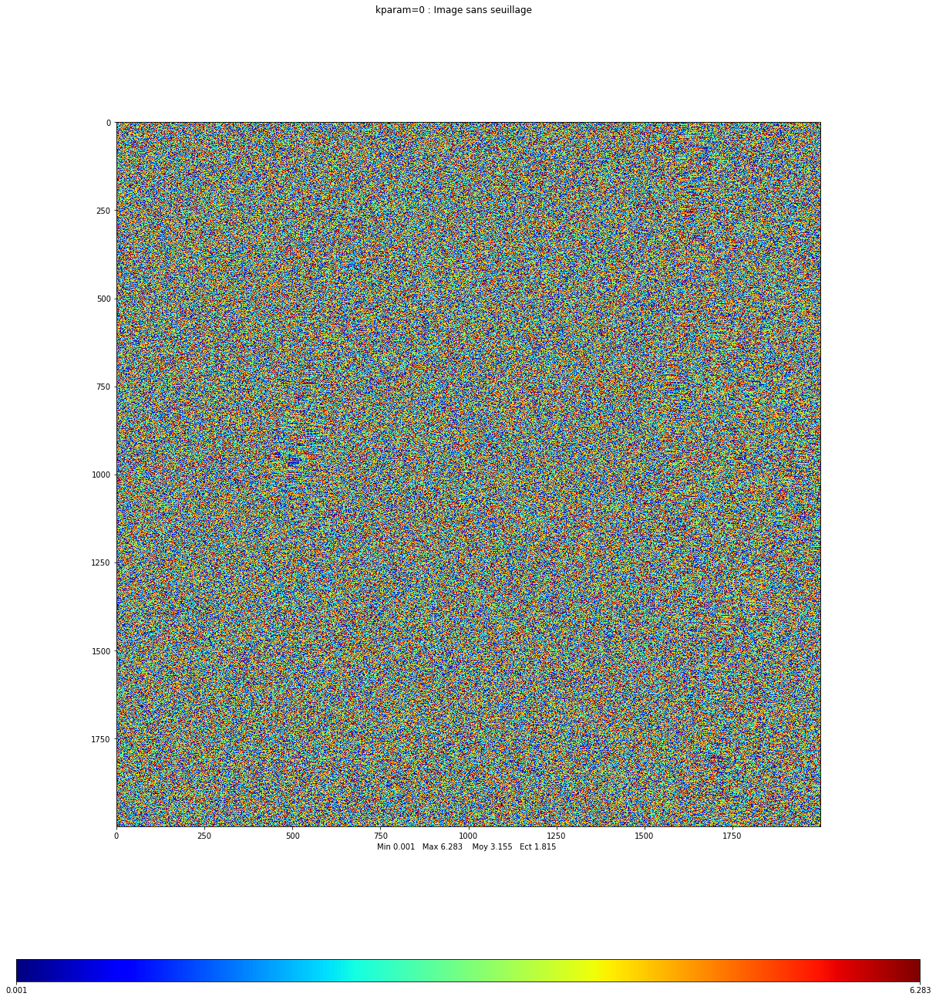

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


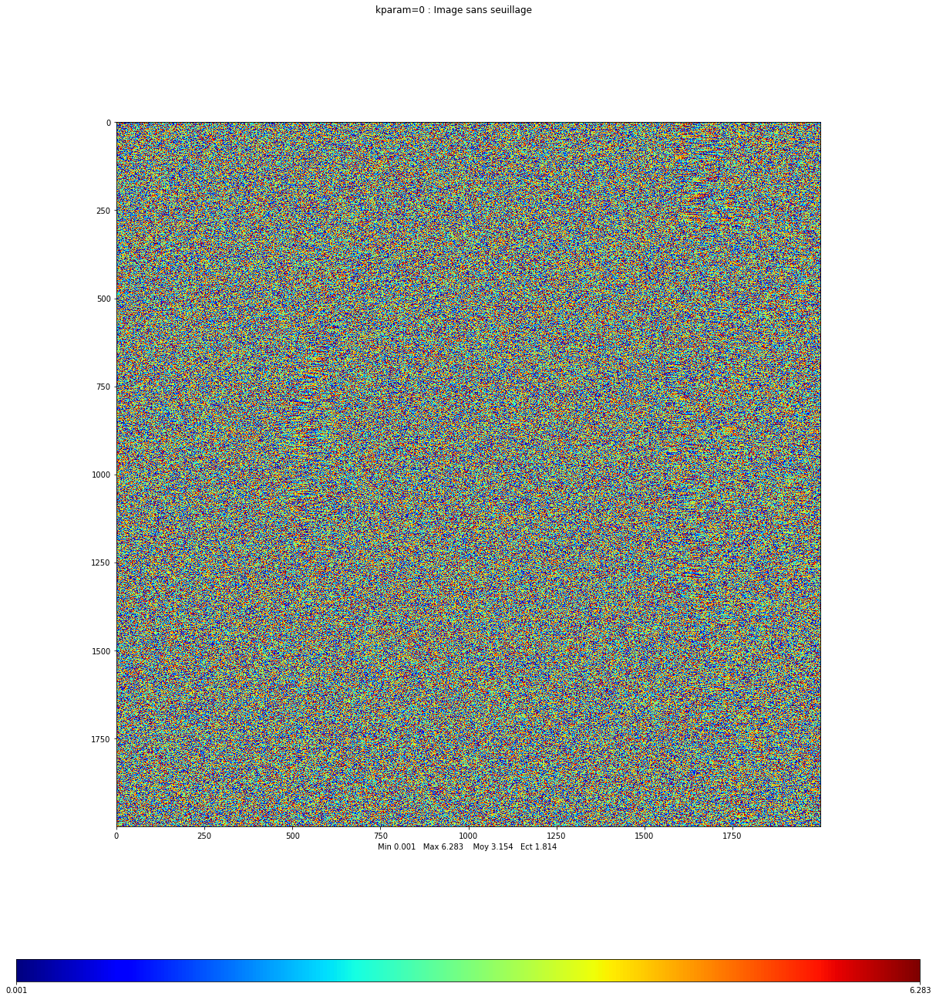

array([[4.30991346e-01, 6.09545795e+00, 5.67764064e+00, ...,
        1.98698855e+00, 1.58299084e+00, 5.82806022e+00],
       [3.03651238e+00, 1.95130270e+00, 5.99743747e-01, ...,
        4.07439332e+00, 3.78509376e+00, 1.50595230e+00],
       [5.04712582e+00, 3.17383954e+00, 2.37437431e+00, ...,
        4.24874137e+00, 3.09285080e+00, 1.82355088e+00],
       ...,
       [4.08619535e+00, 3.84063893e+00, 5.05473884e+00, ...,
        5.78274449e+00, 2.78299659e-01, 4.17657774e+00],
       [5.49445020e-03, 5.08305154e+00, 5.30817353e+00, ...,
        1.01914134e+00, 2.15270144e+00, 1.57079633e+00],
       [1.30908282e+00, 7.99976865e-02, 3.04131232e-01, ...,
        3.30674133e+00, 4.44144213e+00, 4.66048758e+00]])

In [24]:
imageM='./interfero/Master.mat'
imageS='./interfero/Slave.mat'
imamaitre=mvalab.matlab2imz(imageM,'Master')
imaslave=mvalab.matlab2imz(imageS,'Slave')

imamaitre = imamaitre[0][1000:3000,:]
imaslave = imaslave[0][1000:3000,:]
ncolonnes=imamaitre.shape[1]
nlignes=imamaitre.shape[0]

#%%

mvalab.visusar(imamaitre)
mvalab.visusar(imaslave)

# display the phase of one image
plt.rcParams['figure.figsize'] = [21,21]
mvalab.visuinterfero(np.angle(imamaitre)+math.pi,0)
mvalab.visuinterfero(np.angle(imaslave)+math.pi,0)

### Question 4.1
Visualize the phase of an image. Do you see any useful information?

### Answer 4.1
The geometric phase is perturbed by the phase of each pixel and we can’t see much useful information. 

### Question 4.2
Compute the interferogram by computing $z_1.z_2^*$ and display the phase. Do you see any structured pattern ?

### Answer 4.2
We can see some vertical structures forming, but there is a lot of noise due to the fact that the images aren’t well adjusted. 

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


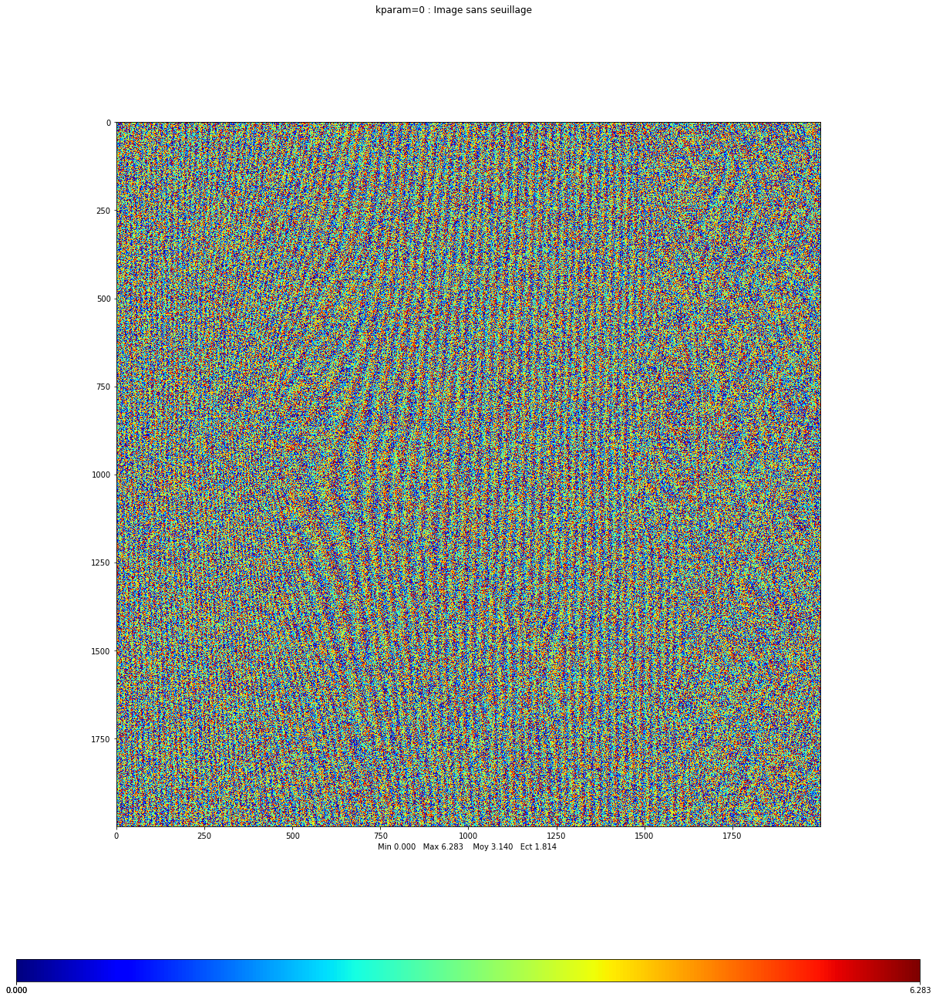

array([[2.55500648, 1.78918891, 1.87616982, ..., 3.10590681, 0.4758385 ,
        3.39207593],
       [0.89047844, 1.22598906, 3.15165491, ..., 1.95913171, 1.51393913,
        2.64900559],
       [5.98842716, 1.99352675, 3.45051094, ..., 4.1410515 , 4.09149189,
        4.72851706],
       ...,
       [0.90900284, 0.57246763, 6.18240116, ..., 0.54691894, 1.60453879,
        4.58963434],
       [0.98723683, 0.62201552, 4.9523198 , ..., 2.27134126, 1.53826569,
        3.19559415],
       [1.87772785, 0.76825464, 6.18330824, ..., 2.72646535, 5.6919621 ,
        4.09109503]])

In [25]:
plt.rcParams['figure.figsize'] = [21,21]
raw_interf = np.multiply(imamaitre,np.conjugate(imaslave))
mvalab.visuinterfero(np.angle(raw_interf)+math.pi,0)

### Question 4.3: Registration of the two images
To compute an interferogram, the following steps have to be applied :
- registration of the two images 
- suppression of the vertical fringe pattern 
- filtering to improve the phase information.

Using the knowledge acquired on previous courses, propose a method and apply it to do the registration between the two images. Complete the code below.

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


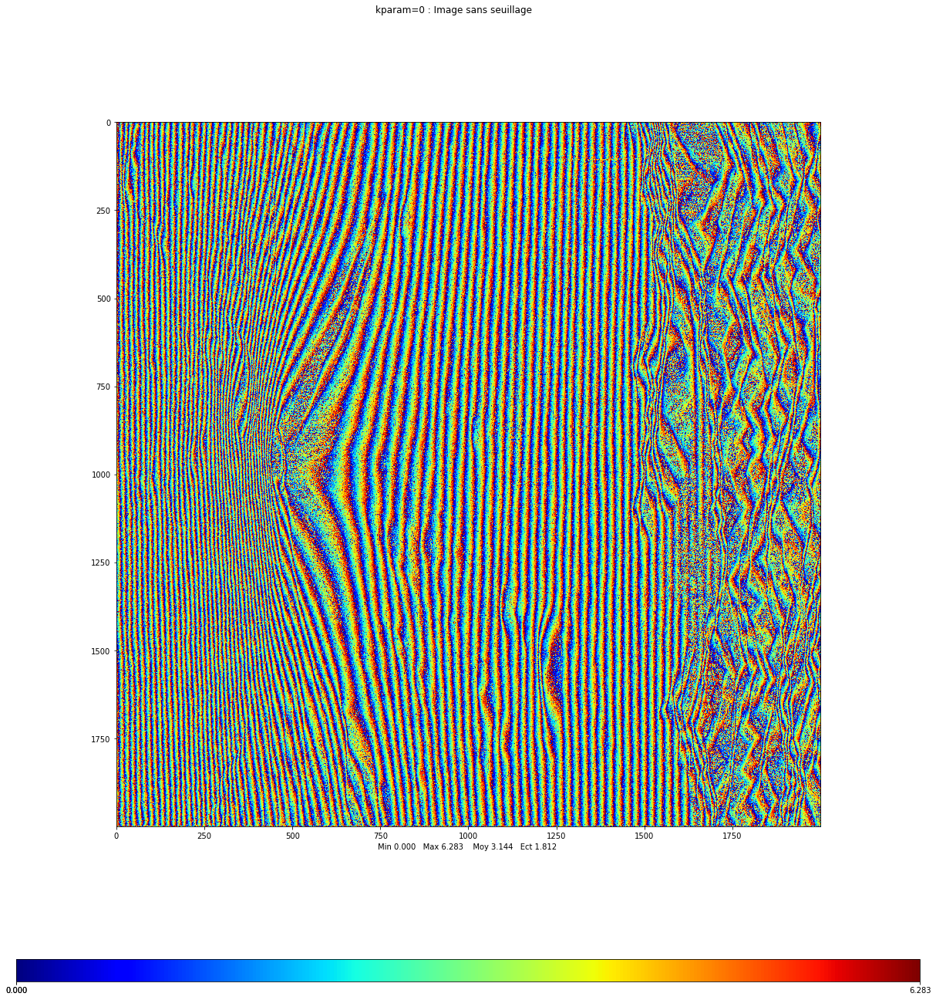

array([[4.22205732, 4.71080733, 5.17943616, ..., 0.84415399, 5.24916385,
        1.11339996],
       [4.88475065, 4.36758172, 4.71439299, ..., 5.99860473, 6.17553618,
        1.2324965 ],
       [4.49176528, 4.6466379 , 4.50604421, ..., 2.97654948, 0.68942589,
        1.65815508],
       ...,
       [3.68611537, 4.33310887, 4.64982345, ..., 3.02292211, 3.72458163,
        4.1057245 ],
       [0.56173994, 5.89279441, 4.58285269, ..., 1.30349405, 2.10797629,
        5.22151557],
       [0.1502983 , 5.18013493, 5.88769572, ..., 1.95881336, 0.06512516,
        0.96244501]])

In [26]:
# propose a method to extract the shift along the two axes
ima1fft=np.fft.fft2(np.abs(imamaitre))
ima2fft=np.fft.fft2(np.abs(imaslave))
# using the multiplication in the Fourier domain, compute the FFT of the correlation and then the correlation by inverse FFT
imacorfft = np.multiply(np.conjugate(ima1fft),ima2fft)
imacor = np.fft.ifft2(imacorfft)
ishift = np.unravel_index(np.argmax(np.abs(imacor)),imacor.shape)

# compute the shift on the two axis
imaslaveroll=np.roll(imaslave, -ishift[0], axis=0)
imaslaveroll=np.roll(imaslaveroll, -ishift[1], axis=1)

# compute the interferogram and plot the interferometric phase
interfero= np.multiply(imamaitre,np.conjugate(imaslaveroll))# to be completed

mvalab.visuinterfero(np.angle(interfero)+math.pi,0)

### Question 4.4
What is the phase shift between the two images ? Which pattern do you see in the resulting fringes when computing the interferogram after the registration ? 

### Answer 4.4
Phase shift between the two images is how one(slave) is deslocated from a reference(maitre). We see a vertical fringe pattern.

### Question 4.5: Suppression of the orbital fringes 
To obtain the useful information about the topography the so-called orbital fringes have to be suppressed. It can be done by using the sensor parameters but in this practical work we propose to use a signal processing method. 
How can you detect a pure sinusoid in a signal ? (it is the case of the pattern we would like to suppress in the horizontal direction). Compute the frequency of this pattern and use it to suppress it in the registered secondary image. 

Which frequency did you obtain ? Is it the same for all the considered lines ? What do you see in the resulting interferogram after correction ? 

### Answer 4.5
The frequency is equal to 88. No, we can observe that 88 is the most relevant frequency among all.

The fringes that are turned in direction of the sensor are narrower, while the ones facing the other side are larger. We can also now observe that they are orbital.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: UserWarning: In Matplotlib 3.3 individual lines on a stem plot will be added as a LineCollection instead of individual lines. This significantly improves the performance of a stem plot. To remove this warning and switch to the new behaviour, set the "use_line_collection" keyword argument to True.
  after removing the cwd from sys.path.


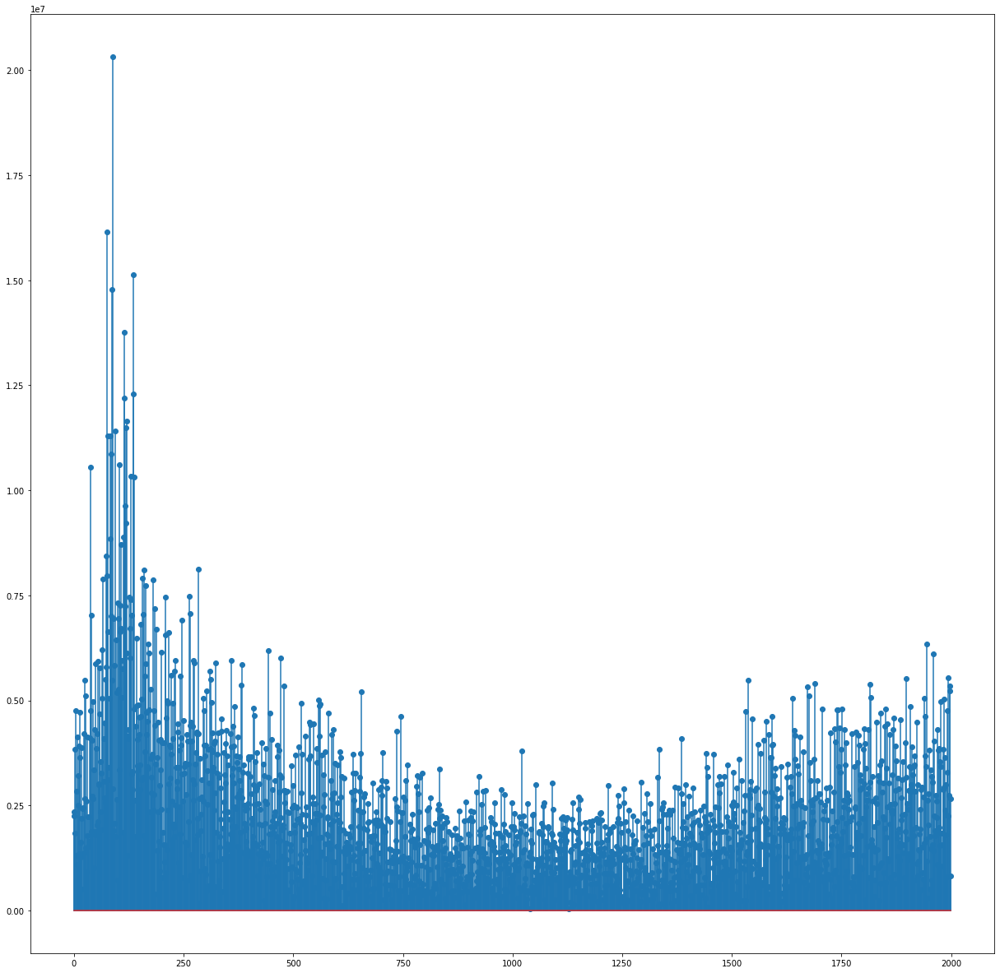

(88,)


In [27]:
# check the pattern for several lines
fftphase = np.abs(np.fft.fft(interfero[0,:]))
plt.figure()
plt.stem(fftphase)
plt.show()

freq = np.unravel_index(np.argmax(np.abs(fftphase)), fftphase.shape)
print(freq)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: UserWarning: In Matplotlib 3.3 individual lines on a stem plot will be added as a LineCollection instead of individual lines. This significantly improves the performance of a stem plot. To remove this warning and switch to the new behaviour, set the "use_line_collection" keyword argument to True.
  


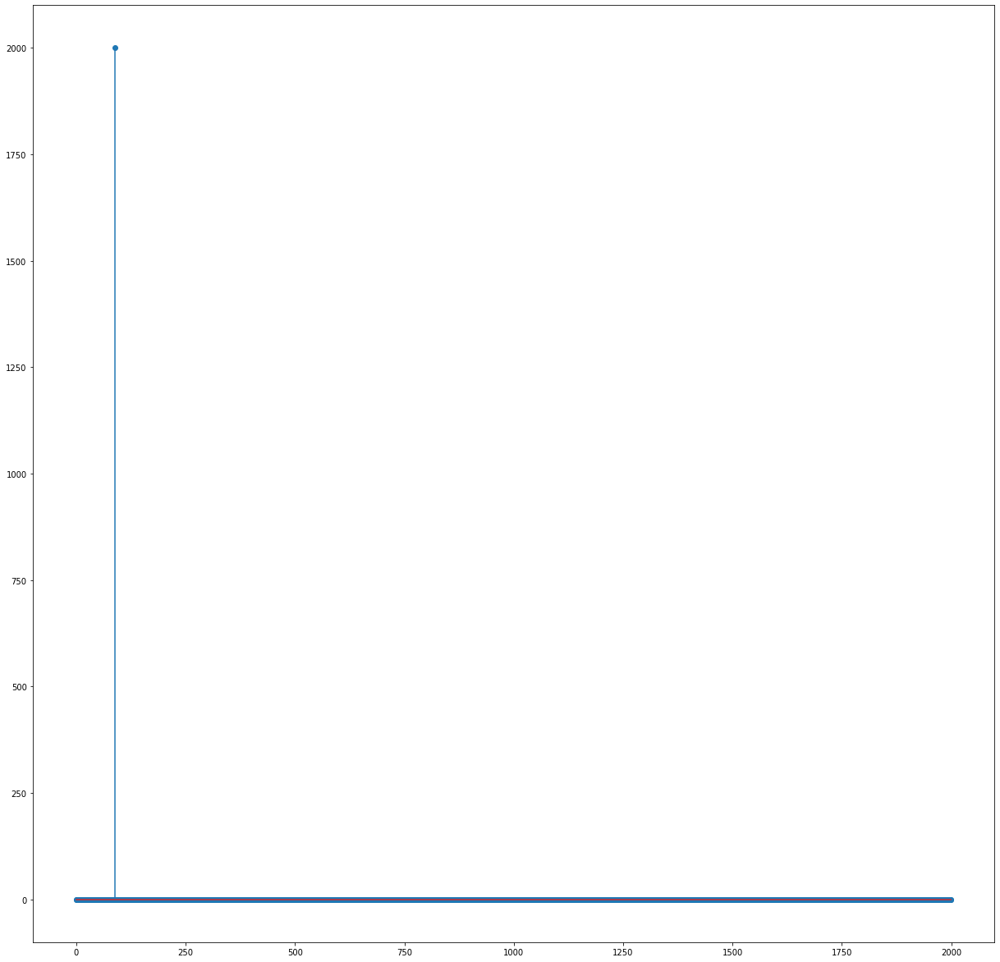

In [28]:
N = interfero.shape[1]
n = np.arange(0,N)
onde = np.exp(1j*2*np.pi*n*freq/N)  # using the previously computed freq to apply the correct phase shift
fonde = np.abs(np.fft.fft(onde))
plt.figure()
plt.stem(fonde)
plt.show()

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


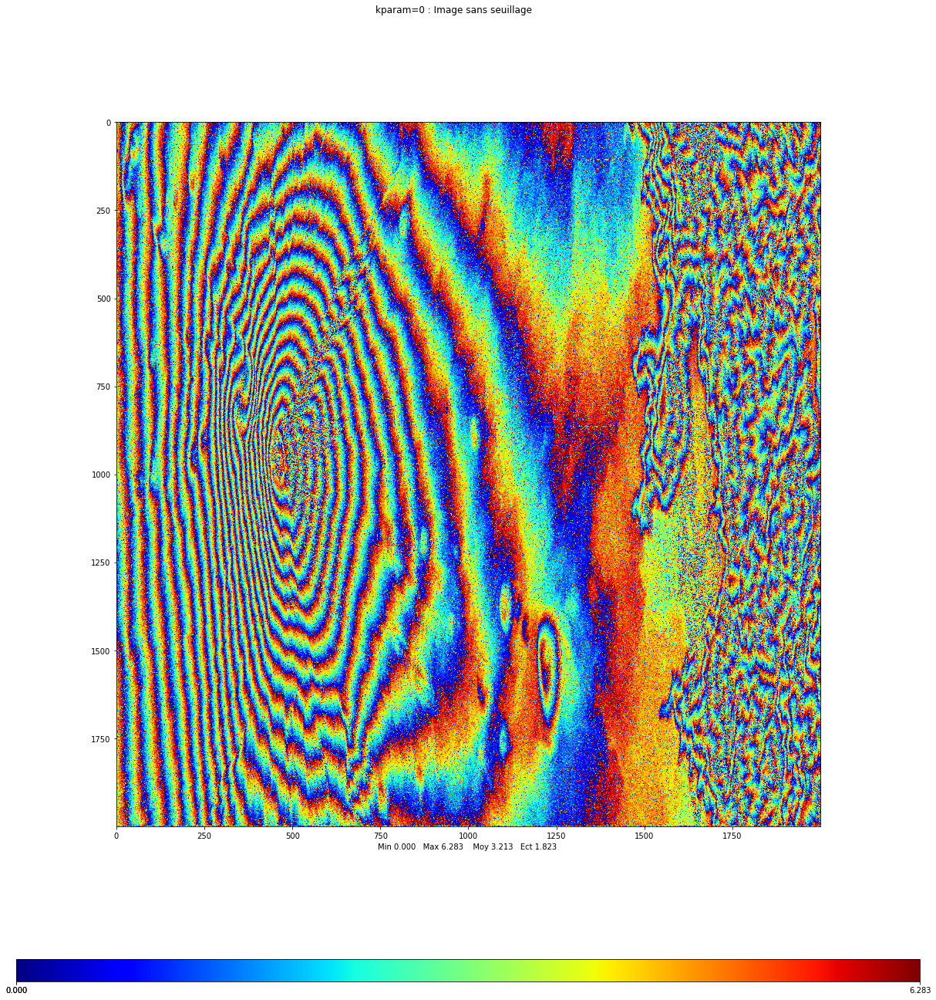

array([[4.22205732, 4.43434718, 4.62651585, ..., 1.67353445, 5.80208416,
        1.38986011],
       [4.88475065, 4.09112156, 4.16147268, ..., 0.54479989, 0.44527118,
        1.50895666],
       [4.49176528, 4.37017774, 3.9531239 , ..., 3.80592994, 1.24234619,
        1.93461524],
       ...,
       [3.68611537, 4.05664871, 4.09690315, ..., 3.85230257, 4.27750193,
        4.38218465],
       [0.56173994, 5.61633426, 4.02993238, ..., 2.13287451, 2.6608966 ,
        5.49797572],
       [0.1502983 , 4.90367477, 5.33477542, ..., 2.78819382, 0.61804547,
        1.23890516]])

In [30]:
imaslavefine= np.multiply(imaslaveroll,onde) # apply the phase shift using the Fourier wave you have created
interferofine= np.multiply(imamaitre,np.conjugate(imaslavefine))

mvalab.visuinterfero(np.angle(interferofine)+math.pi,0)

### Question 4.6: interferogram filtering
To improve the quality of the interferogram, some filtering can be applied to reduce the phase noise. Propose a suitable kernel by filling the code below.

How does the filtered interferogram look like?

### Answer 4.6
Phase is to do it over  z1.z∗2  in a small window and using  z1.z∗2  phase. It’s darker where we have more noise. 

In [33]:
def interferogramme( tabvignette, tabvignette2, *therest) :
    """
    Computation of the complex interferogram between two images of the
    same size.
    By default, window size is set as 3x3 (dimx, dimy).
    It outputs a complex image, whose modulus is the coherence and whose phase 
    is the interferometric phase.
    """
    
    dimx=3
    dimy=3
    
    if(len(therest)==1):        
        dimx=therest[0]
        dimy=dimx
        
    if(len(therest)==2):       
        dimx=therest[0]
        dimy=therest[1]
    
    nlig=np.size(tabvignette,0)
    ncol=np.size(tabvignette,1)
    
    if nlig != np.size(tabvignette2,0)  :
        print(u'les deux images doivent avoir la même taille (%d  et %d)'%(nlig, np.size(tabvignette2,0)))
        return 0
    
    if ncol != np.size(tabvignette2,1)  :
        print(u'les deux images doivent avoir la même taille')
        return 0
    
    interf= np.multiply(tabvignette, np.conj(tabvignette2))

    # part to be completed to compute a multi-look interfergram by averaging on a local window
    
    
    mask = np.ones((dimx,dimy))/(dimx*dimy) # to be completed
    interfiltr = signal.convolve2d(interf,mask,mode='same')
    
    den1 = np.sqrt(signal.convolve2d(np.square(np.abs(tabvignette)),mask,mode='same'))
    den2 = np.sqrt(signal.convolve2d(np.square(np.abs(tabvignette2)),mask,mode='same'))
 
    return interfiltr/(den1*den2+1e-12)

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


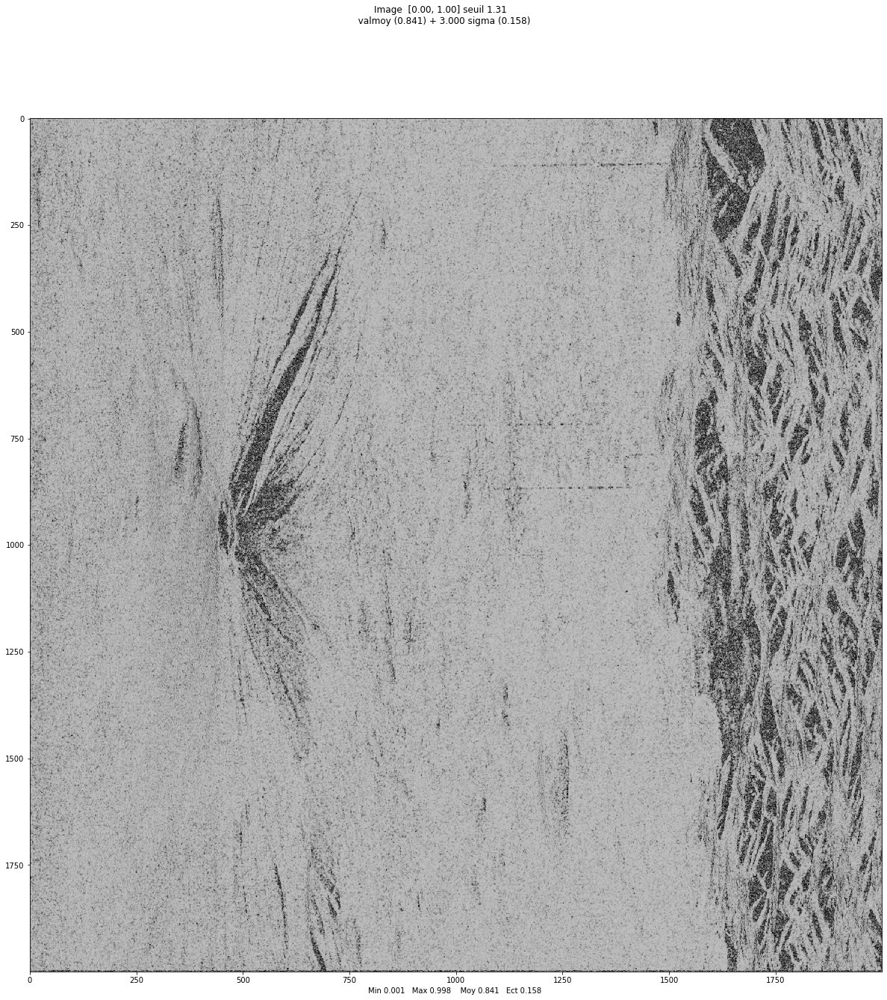

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


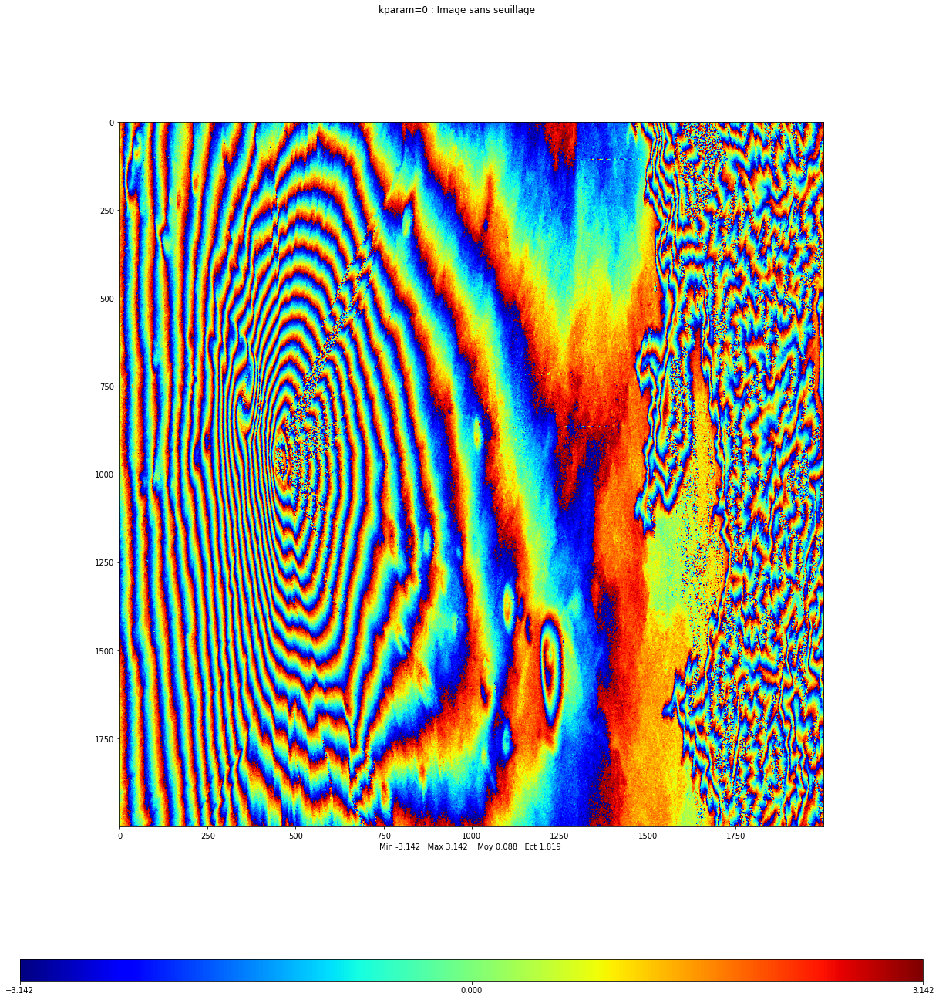

array([[ 1.2279969 ,  1.21967119,  1.65677293, ..., -2.47301535,
        -2.29274868, -2.20971056],
       [ 1.25835103,  1.2242175 ,  1.51653665, ..., -2.43612639,
        -2.12147544, -1.99736159],
       [ 1.49096764,  1.41154218,  1.4575004 , ..., -2.62105169,
        -2.357279  , -2.12231918],
       ...,
       [ 1.12950458,  1.0649053 ,  1.15034095, ...,  0.12188607,
         0.68587499,  1.86577684],
       [ 2.47500127,  2.29224644,  1.45834327, ..., -0.01770806,
        -0.95581559, -2.93627923],
       [ 3.06177211,  2.91110301,  2.10977673, ..., -0.24029512,
        -1.21612621, -2.57514978]])

In [34]:
filtered_interferogram = interferogramme(imamaitre,imaslavefine)
mvalab.visusar(np.abs(filtered_interferogram))
mvalab.visuinterfero(np.angle(filtered_interferogram),0)

### Question 4.7
Can you apply the convolution directly on the interferometric phase image ? 
What would happen in that case?

### Question 4.7
No, because of the $2\pi$ modulation. The only way to properly average the phase is to do it over $z_1.z_2^*$ in a small window and using $z_1.z_2^*$ phase.